In [14]:
import librosa
import IPython.display as ipd

%matplotlib inline
import matplotlib.pyplot as plt
import librosa.display

import numpy as np
import sklearn

In [2]:
audio_path = 'Stasis - Maozon.wav'
x , sr = librosa.load(audio_path)

In [3]:
print(x.shape, sr)

(3411201,) 22050


In [4]:
ipd.Audio(audio_path)

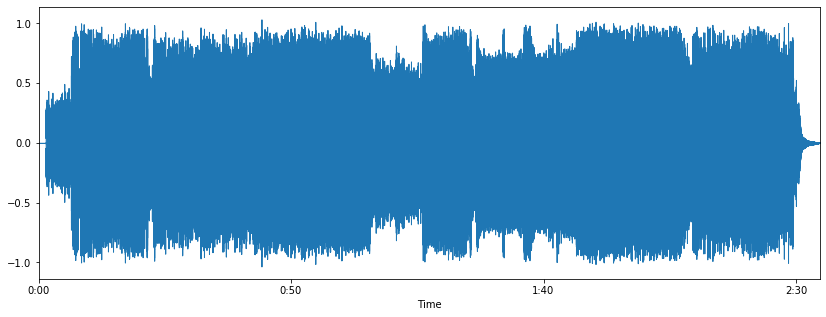

In [5]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(x, sr=sr)

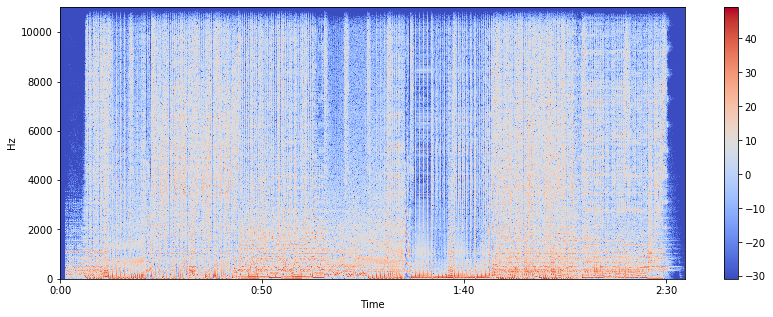

In [6]:
X = librosa.stft(x)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')
plt.colorbar()

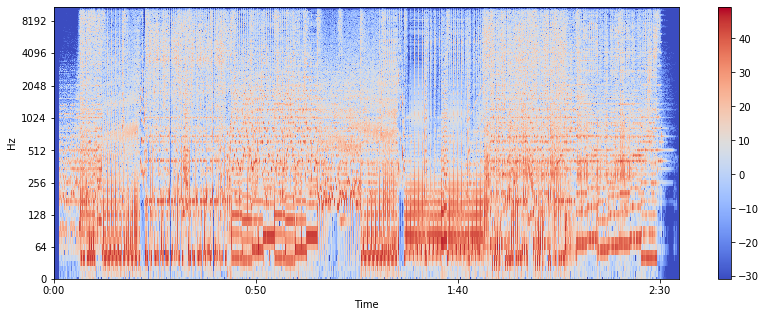

In [7]:
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
plt.colorbar()

In [8]:
sr = 22050 # sample rate
T = 5.0    # seconds
t = np.linspace(0, T, int(T*sr), endpoint=False) # time variable
x = 0.5*np.sin(2*np.pi*220*t)# pure sine wave at 220 Hz

ipd.Audio(x, rate=sr) # load a NumPy array

librosa.output.write_wav('tone_220.wav', x, sr)

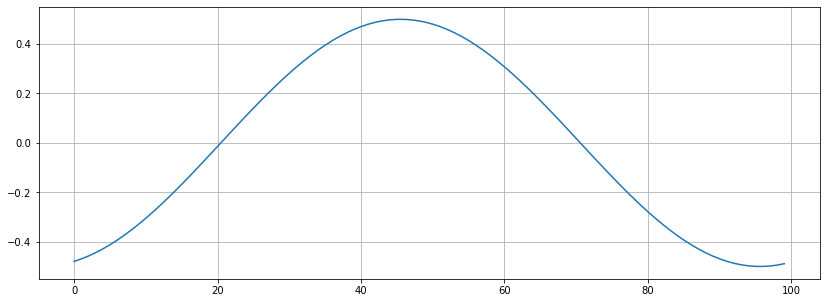

In [10]:
# Zooming in
n0 = 9000
n1 = 9100
plt.figure(figsize=(14, 5))
plt.plot(x[n0:n1])
plt.grid()

In [11]:
zero_crossings = librosa.zero_crossings(x[n0:n1], pad=False)
print(sum(zero_crossings))

2


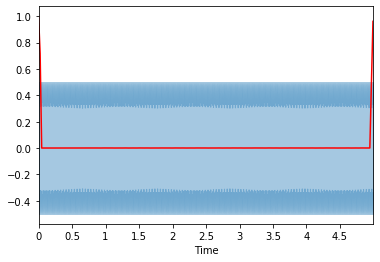

In [17]:
spectral_centroids = librosa.feature.spectral_centroid(x, sr=sr)[0]
spectral_centroids.shape

# Computing the time variable for visualization
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames)
# Normalising the spectral centroid for visualisation
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)
#Plotting the Spectral Centroid along the waveform
librosa.display.waveplot(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_centroids), color='r')

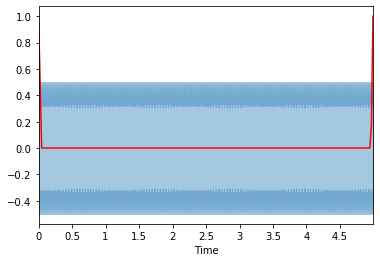

In [18]:
spectral_rolloff = librosa.feature.spectral_rolloff(x+0.01, sr=sr)[0]
librosa.display.waveplot(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_rolloff), color='r')

(20, 216)


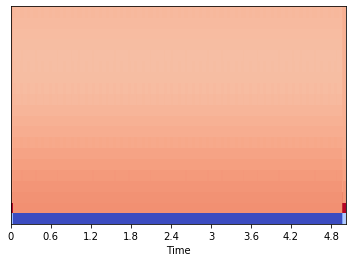

In [21]:
mfccs = librosa.feature.mfcc(x, sr=sr)
print(mfccs.shape)

#Displaying  the MFCCs:
librosa.display.specshow(mfccs, sr=sr, x_axis='time')

[ 2.2075795e-09 -2.2075795e-09  2.2075795e-09  2.2075795e-09
  0.0000000e+00  0.0000000e+00 -4.4151589e-09 -4.4151589e-09
 -6.6227384e-09 -4.4151589e-09 -4.4151589e-09  2.2075795e-09
 -2.2075795e-09  4.4151589e-09 -2.2075795e-09  2.2075795e-09
  2.2075795e-09 -2.2075795e-09  4.4151589e-09  2.2075795e-09]
[1.         1.0000001  1.0000001  0.9999999  1.0000001  0.9999999
 1.0000001  1.0000001  1.0000001  1.0000001  0.99999994 0.9999999
 1.         1.0000001  0.99999976 1.0000001  1.0000001  1.
 1.0000001  1.        ]


c:\users\abtahi chowdhury\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\_data.py:173: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn("Numerical issues were encountered "
c:\users\abtahi chowdhury\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\_data.py:190: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn("Numerical issues were encountered "


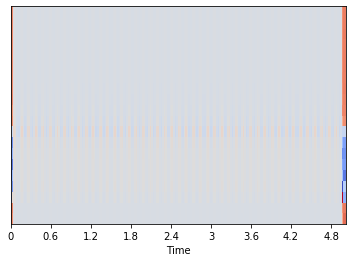

In [22]:
mfccs = sklearn.preprocessing.scale(mfccs, axis=1)
print(mfccs.mean(axis=1))
print(mfccs.var(axis=1))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')